### Imports

In [108]:
import pandas as pd
import numpy as np
import geopandas as gpd

In [109]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline 
mpl.rcParams['figure.dpi'] = 300

In [110]:
from sklearn.preprocessing import Normalizer

In [111]:
pd.options.display.max_rows = 4000
pd.options.display.max_columns = 4000

### Setup

In [112]:
cgi_csv = '../data/institutions_data_prepped.csv'

In [113]:
cgi_df = pd.read_csv(cgi_csv)

In [114]:
cgi_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforc

Note: CGI -> CGI *mechanisms*

In [115]:
cgi_only_df = cgi_df[cgi_df['CGI'].notna()]

In [116]:
cgi_only_df.head()

,Institution_Name,Community_Name,Mechanism,Culture/Values/Norms,Notes,Time span,Time span: Start,Time span: End,Geography,Size,Source,Heterogeneity,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforc

In [117]:
cgi_mechanisms_list = [x for x in cgi_only_df.columns if 'cgis_include_' in x]
cgi_mechanisms_list

['access_cgis_include_matriarchy',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_frequent_and_or_regular_meetings',
 'enforcement_cgis_include_scrutiny_of_officials',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_agenda_setting',
 'decision_making_cgis_include_secret_ballot',
 'access_cgis_include_life_appointment',
 'access_cgis_include_gerontocracy',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_quorum',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_unanimity',
 'decision_making_cgis_include_council_local',
 'decision_making_cgis_include_board_commit

In [118]:
cgi_mechanisms_df = cgi_only_df[cgi_mechanisms_list]

In [119]:
cgi_mechanisms_df

,access_cgis_include_matriarchy,decision_making_cgis_include_consent,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_turnover_rotation,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_secret_ballot,access_cgis_include_life_appointment,access_cgis_include_gerontocracy,decision_making_cgis_include_assembly_local,decision_making_cgis_include_quorum,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_unanimity,decision_making_cgis_include_council_local,decision_making_cgis_include_board_committee,decision_making_cgis_include_deliberation,access_cgis_include_meritocracy,decision_making_cgis_include_council_central_,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,access_cgis_include_heredity,decision_making_cgis_include_representation,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_majority_voting,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_central,decision_making_cgis_include_remunerated_position,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_voting,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_delegation,access_cgis_include_property_requirement,enforcement_cgis_include_judicial_review,enforcement_cgis_include_litigation,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries,decision_making_cgis_include_oath,access_cgis_include_matrilineality,access_cgis_include_popularity_,access_cgis_include_blood_relations,decision_making_cgis_include_consultation,access_cgis_include_lottery_random_selection,decision_making_cgis_include_consensus,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_appeal,access_cgis_include_co-optation,decision_making_cgis_include_public_meetings,enforcement_cgis_include_criticism_mocking_joking
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
18,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
21,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
25,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
29,0,0,1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,1,0,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
31,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0


In [120]:
cgi_mechanisms_df.sum().sort_values(ascending=False)

decision_making_cgis_include_council_central_                           41
decision_making_cgis_include_assembly_central                           29
decision_making_cgis_include_council_local                              25
decision_making_cgis_include_frequent_and_or_regular_meetings           16
enforcement_cgis_include_tribunal_court_                                15
decision_making_cgis_include_deliberation                               14
decision_making_cgis_include_consensus                                  14
access_cgis_include_election                                            14
decision_making_cgis_include_assembly_local                             13
decision_making_cgis_include_representation                             13
decision_making_cgis_include_majority_voting                             9
decision_making_cgis_include_public_meetings                             8
decision_making_cgis_include_temporary_position_of_power_term_limits     8
decision_making_cgis_incl

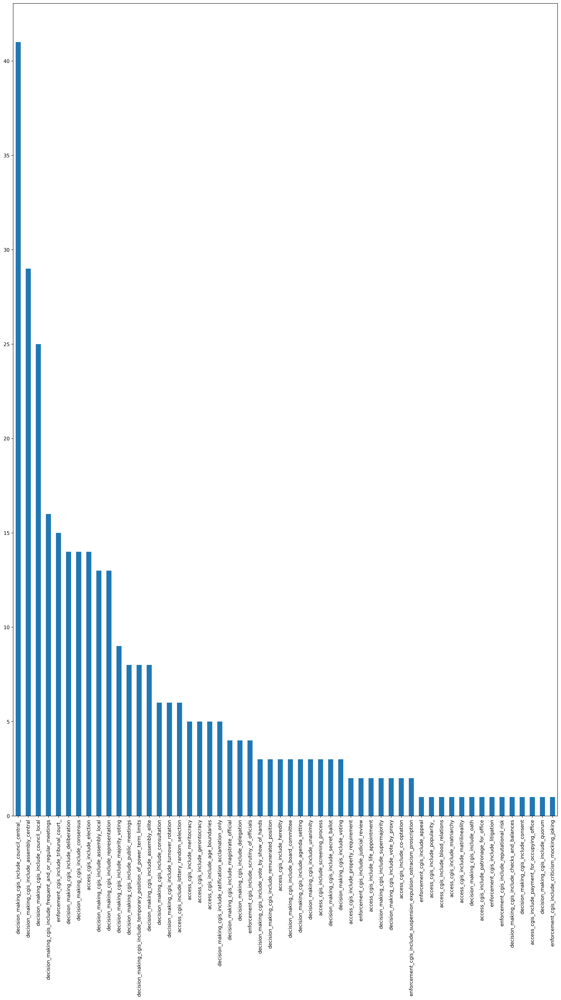

In [121]:
cgi_mechanisms_df.sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

plt.savefig('../fig/cgis_histogram.png')

TODO: 
  - comparative analysis b/n CGI mechanisms and non-CGI mechanisms

## By Mechanism category

In [122]:
access_cgis = [x for x in cgi_df.columns if 'access_cgis_' in x]

In [123]:
cgi_df[access_cgis]

,access_cgis_include_matriarchy,access_cgis_include_election,access_cgis_include_life_appointment,access_cgis_include_gerontocracy,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,access_cgis_include_meritocracy,access_cgis_include_heredity,access_cgis_include_property_requirement,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries,access_cgis_include_matrilineality,access_cgis_include_popularity_,access_cgis_include_blood_relations,access_cgis_include_lottery_random_selection,access_cgis_include_co-optation
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


<Axes: >

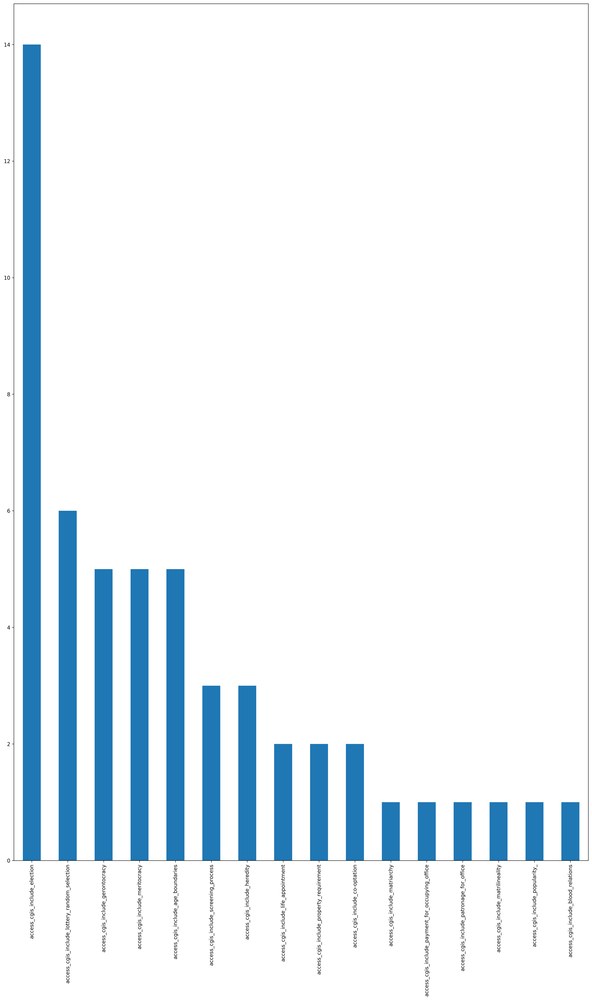

In [124]:
cgi_df[access_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

In [125]:
decision_making_cgis = [x for x in cgi_df.columns if 'decision_making_cgis_' in x]

<Axes: >

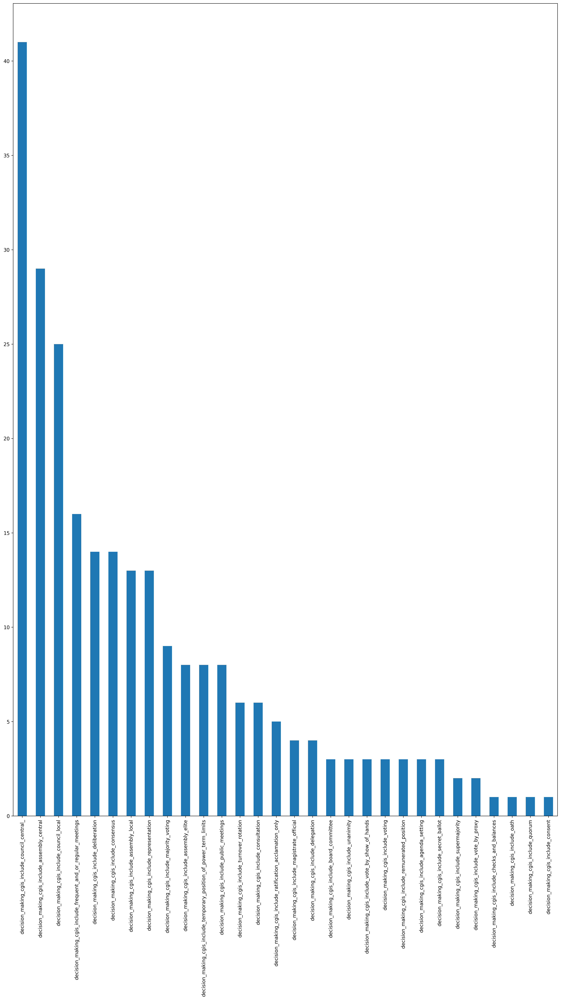

In [126]:
cgi_df[decision_making_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

In [127]:
enforcement_cgis = [x for x in cgi_df.columns if 'enforcement_cgis_' in x]

<Axes: >

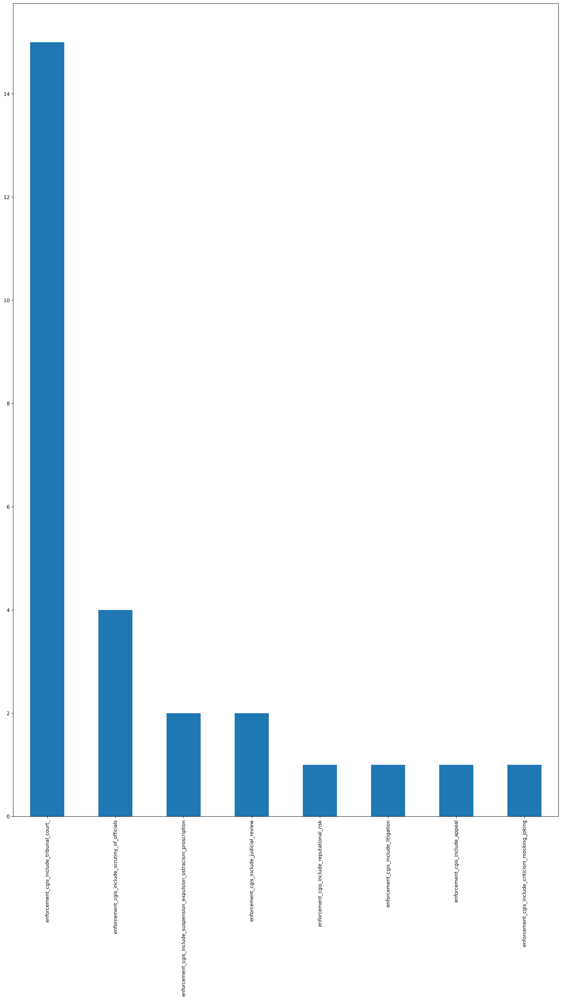

In [128]:
cgi_mechanisms_df[enforcement_cgis].sum().sort_values(ascending=False).plot(kind='bar', figsize=(20,30))

# CGI Mechanism Analysis 

In [21]:
# Select columns of interest

In [22]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_induction_rite_ceremony',
 'decision_making_mechanisms_include_assembly_elite',
 'access_mechanisms_include_patronage_for_office',
 'decision_making_mechanisms_include_supermajority',
 'decision_making_mechanisms_include_mandate',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_veto',
 'access_mechanisms_include_matriarchy',
 'decision_making_mechanisms_include_board_committee',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'decision_making_mechanisms_include_voting',
 'access_mechanisms_include_popularity_',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_secret_ballot',
 'decision_making_mechanisms_include_lobbying',
 

In [23]:
# Drop community mechanisms
mechanisms_list = [x for x in cgi_df.columns if x.startswith('mechanisms')]
mechanisms_list

[]

In [24]:
cgi_df.drop(columns=mechanisms_list, inplace=True)

In [25]:
list(cgi_df)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_induction_rite_ceremony',
 'decision_making_mechanisms_include_assembly_elite',
 'access_mechanisms_include_patronage_for_office',
 'decision_making_mechanisms_include_supermajority',
 'decision_making_mechanisms_include_mandate',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_veto',
 'access_mechanisms_include_matriarchy',
 'decision_making_mechanisms_include_board_committee',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'decision_making_mechanisms_include_voting',
 'access_mechanisms_include_popularity_',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_secret_ballot',
 'decision_making_mechanisms_include_lobbying',
 

## Normalized Correlation Matrix

In [26]:
data_plot = cgi_df.select_dtypes(include=[np.number])

In [27]:
data_plot.describe()

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

In [28]:
data_plot

In [29]:
normalized = Normalizer().fit_transform(data_plot)

norm_df = pd.DataFrame(normalized)
norm_df.columns = data_plot.columns
norm_corr = norm_df.corr()

norm_corr

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

In [30]:
norm_corr.head()

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

# Visualize and Sort CGI Correlations

In [31]:
plt.figure(figsize=(60, 60))

# define the mask to set the values in the upper triangle to True
mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))

triangle_heatmap = sns.heatmap(
    norm_corr, 
    mask=mask, 
    vmin=-1, 
    vmax=1, 
    annot=False, 
    cmap='BrBG', 
    xticklabels=1, 
    yticklabels=1)

triangle_heatmap.set_title('Triangle Correlation triangle_heatmap', fontdict={'fontsize':18}, pad=16);

plt.show()
plt.savefig('../fig/cgis_triangle_correlations.png')

/var/folders/v7/8x_7ty4j3m76hgg7tncks_kc0000gn/T/ipykernel_2518/2314798905.py:4: DeprecationWarning: `np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  mask = np.triu(np.ones_like(norm_corr, dtype=np.bool))


<Figure size 1920x1440 with 0 Axes>

In [49]:
cgis_list = [x for x in cgi_df.columns if 'cgis_' in x]
cgis_list

['access_cgis_include_matriarchy',
 'decision_making_cgis_include_consent',
 'decision_making_cgis_include_frequent_and_or_regular_meetings',
 'enforcement_cgis_include_scrutiny_of_officials',
 'decision_making_cgis_include_turnover_rotation',
 'access_cgis_include_election',
 'enforcement_cgis_include_tribunal_court_',
 'decision_making_cgis_include_ratification_acclamation_only',
 'decision_making_cgis_include_agenda_setting',
 'decision_making_cgis_include_secret_ballot',
 'access_cgis_include_life_appointment',
 'access_cgis_include_gerontocracy',
 'decision_making_cgis_include_assembly_local',
 'decision_making_cgis_include_quorum',
 'enforcement_cgis_include_suspension_expulsion_ostracism_proscription',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'decision_making_cgis_include_magistrate_official',
 'decision_making_cgis_include_unanimity',
 'decision_making_cgis_include_council_local',
 'decision_making_cgis_include_board_commit

In [50]:
cgis_df = norm_corr[cgis_list]

In [51]:
cgis_df

,access_cgis_include_matriarchy,decision_making_cgis_include_consent,decision_making_cgis_include_frequent_and_or_regular_meetings,enforcement_cgis_include_scrutiny_of_officials,decision_making_cgis_include_turnover_rotation,access_cgis_include_election,enforcement_cgis_include_tribunal_court_,decision_making_cgis_include_ratification_acclamation_only,decision_making_cgis_include_agenda_setting,decision_making_cgis_include_secret_ballot,access_cgis_include_life_appointment,access_cgis_include_gerontocracy,decision_making_cgis_include_assembly_local,decision_making_cgis_include_quorum,enforcement_cgis_include_suspension_expulsion_ostracism_proscription,access_cgis_include_payment_for_occupying_office,access_cgis_include_screening_process,decision_making_cgis_include_magistrate_official,decision_making_cgis_include_unanimity,decision_making_cgis_include_council_local,decision_making_cgis_include_board_committee,decision_making_cgis_include_deliberation,access_cgis_include_meritocracy,decision_making_cgis_include_council_central_,decision_making_cgis_include_vote_by_proxy,decision_making_cgis_include_assembly_elite,access_cgis_include_heredity,decision_making_cgis_include_representation,decision_making_cgis_include_temporary_position_of_power_term_limits,decision_making_cgis_include_majority_voting,decision_making_cgis_include_supermajority,decision_making_cgis_include_assembly_central,decision_making_cgis_include_remunerated_position,decision_making_cgis_include_checks_and_balances,decision_making_cgis_include_voting,enforcement_cgis_include_reputational_risk,decision_making_cgis_include_delegation,access_cgis_include_property_requirement,enforcement_cgis_include_judicial_review,enforcement_cgis_include_litigation,access_cgis_include_patronage_for_office,access_cgis_include_age_boundaries,decision_making_cgis_include_oath,access_cgis_include_matrilineality,access_cgis_include_popularity_,access_cgis_include_blood_relations,decision_making_cgis_include_consultation,access_cgis_include_lottery_random_selection,decision_making_cgis_include_consensus,decision_making_cgis_include_vote_by_show_of_hands,enforcement_cgis_include_appeal,access_cgis_include_co-optation,decision_making_cgis_include_public_meetings,enforcement_cgis_include_criticism_mocking_joking
Time span: Start,-0.076989,0.007594,-0.050008,-0.147057,-0.133303,-0.102244,-0.044074,-0.087401,-0.095061,-0.094373,0.059003,0.016237,0.080337,-0.069769,-0.063022,0.031953,-0.125202,-0.115590,0.023383,0.163814,-0.090803,-0.046191,0.094608,-0.144420,0.063983,0.036615,0.071806,-0.000693,-0.119953,-0.095989,0.056599,-0.172832,-0.129095,0.030490,-0.049090,0.031953,-0.076541,-0.098821,-0.064754,-0.076495,0.046661,-0.147238,-0.076495,0.031953,0.032645,0.031432,-0.025696,-0.157945,-0.005502,-0.094373,0.039810,0.063212,-0.087888,0.048770
Time span: End,-0.080700,0.042017,-0.054176,-0.124434,-0.113087,-0.064786,-0.025590,-0.042166,-0.077041,-0.080699,0.058430,0.013879,0.055517,-0.038458,-0.073581,0.044614,-0.094220,-0.085615,0.023454,0.142745,-0.074296,-0.025938,0.089365,-0.094661,0.055022,0.035652,0.069272,-0.004224,-0.117391,-0.093735,0.057950,-0.105770,-0.120771,0.044828,-0.055683,0.044614,-0.032651,-0.054471,-0.069076,-0.084340,0.038154,-0.164353,-0.084340,0.044614,0.044493,0.044697,-0.011751,-0.140895,0.001512,-0.080699,0.042318,0.055452,-0.063418,0.036260
access_mechanisms_include_enfranchisement,-0.012064,-0.012064,-0.041194,-0.024233,-0.026909,0.278304,-0.041275,-0.020465,-0.019177,-0.018835,-0.017085,-0.026427,-0.042838,-0.012064,-0.014560,-0.012064,-0.020954,-0.022786,-0.020638,-0.061850,-0.019578,-0.037574,-0.026968,0.062189,-0.017055,-0.033388,-0.020828,-0.037643,-0.030304,-0.030549,-0.016721,0.136775,-0.020955,-0.012064,-0.017662,-0.012064,-0.021625,-0.017087,-0.014908,-0.012064,-0.012064,-0.025473,-0.012064,-0.012064,-0.012064,-0.012064,-0.027344,-0.028757,-0.037569,-0.018835,-0.012064,-0.016964,-0.029215,-0.012064
access_mechanisms_include_induction_rite_ceremony,-0.004318,-

In [52]:
query_cgis_df = cgis_df.transpose()

In [53]:
query_cgis_df.head()

,Time span: Start,Time span: End,access_mechanisms_include_enfranchisement,access_mechanisms_include_induction_rite_ceremony,decision_making_mechanisms_include_assembly_elite,access_mechanisms_include_patronage_for_office,decision_making_mechanisms_include_supermajority,decision_making_mechanisms_include_mandate,access_mechanisms_include_gerontocracy,decision_making_mechanisms_include_veto,access_mechanisms_include_matriarchy,decision_making_mechanisms_include_board_committee,decision_making_mechanisms_include_frequent_and_or_regular_meetings,decision_making_mechanisms_include_voting,access_mechanisms_include_popularity_,decision_making_mechanisms_include_representation,decision_making_mechanisms_include_secret_ballot,decision_making_mechanisms_include_lobbying,access_mechanisms_include_dreaming,access_mechanisms_include_open_political_unit,access_mechanisms_include_life_appointment,access_mechanisms_include_property_requirement,decision_making_mechanisms_include_unanimity,decision_making_mechanisms_include_bureaucracy,decision_making_mechanisms_include_deliberation,access_mechanisms_include_lottery_random_selection,enforcement_mechanisms_include_tribunal_court_,enforcement_mechanisms_include_monitoring,decision_making_mechanisms_include_power_fluidity,decision_making_mechanisms_include_alliance,decision_making_mechanisms_include_vote_by_proxy,decision_making_mechanisms_include_coalition,decision_making_mechanisms_include_president_consul_chief_executive,enforcement_mechanisms_include_police,enforcement_mechanisms_include_criticism_mocking_joking,enforcement_mechanisms_include_scrutiny_of_officials,enforcement_mechanisms_include_graduated_sanctions,decision_making_mechanisms_include_consent,decision_making_mechanisms_include_majority_voting,decision_making_mechanisms_include_quorum,decision_making_mechanisms_include_word_of_mouth,decision_making_mechanisms_include_ratification_acclamation_only,decision_making_mechanisms_include_council_central_,decision_making_mechanisms_include_remunerated_position,decision_making_mechanisms_include_vote_by_show_of_hands,enforcement_mechanisms_include_litigation,decision_making_mechanisms_include_delegation,decision_making_mechanisms_include_kingchief-as-figurehead,decision_making_mechanisms_include_group_voting,decision_making_mechanisms_include_temporary_position_of_power_term_limits,enforcement_mechanisms_include_self-help,enforcement_mechanisms_include_suspension_expulsion_ostracism_proscription,enforcement_mechanisms_include_arbitration,decision_making_mechanisms_include_oath,enforcement_mechanisms_include_military_force,enforcement_mechanisms_include_destruction_of_property,decision_making_mechanisms_include_handshake,decision_making_mechanisms_include_magistrate_official,access_mechanisms_include_co-optation,enforcement_mechanisms_include_forced_labour,access_mechanisms_include_divine_right,decision_making_mechanisms_include_dual-sex_political_system,enforcement_mechanisms_include_appeal,decision_making_mechanisms_include_autocratic_leader_chief_bound,decision_making_mechanisms_include_petition,decision_making_mechanisms_include_confederacy,enforcement_mechanisms_include_mediation,enforcement_mechanisms_include_judicial_review,decision_making_mechanisms_include_leader_first_among_equals,access_mechanisms_include_election,enforcement_mechanisms_include_negotiation,decision_making_mechanisms_include_council_local,access_mechanisms_include_age_boundaries,enforcement_mechanisms_include_jury_judge,enforcement_mechanisms_include_reputational_risk,decision_making_mechanisms_include_agenda_setting,decision_making_mechanisms_include_rule_of_law,access_mechanisms_include_heredity,enforcement_mechanisms_include_paying_damages_compensation,enforcement_mechanisms_include_capital_punishment,decision_making_mechanisms_include_assembly_local,access_mechanisms_include_matrilineality,enforcement_mechanisms_include_civil_disobedience,enforcement_mechanisms_include_seizing_of_property,decision_making_mech

## Time x Region x Size for CGIs

In [54]:
time_span_cols = ['Time span: Start', 'Time span: End', 'Time span: Duration']

In [55]:
region_cols = [r for r in list(cgi_df) if 'Region: ' in r] 

In [56]:
size_cols = [
    'Size: 100 - 1,000',
    'Size: 1,001 - 10,000',
    'Size: 10,001 - 100,000',
    'Size: 100,001 - 1,000,000',
    'Size: 1,000,001 - 10,000,000',
    'Size: 10,000,000+',
    'Size: Unknown'
]

In [57]:
list(cgi_df.columns)

['Institution_Name',
 'Community_Name',
 'Mechanism',
 'Culture/Values/Norms',
 'Notes',
 'Time span',
 'Time span: Start',
 'Time span: End',
 'Geography',
 'Size',
 'Source',
 'Heterogeneity ',
 'access_mechanisms_include_enfranchisement',
 'access_mechanisms_include_induction_rite_ceremony',
 'decision_making_mechanisms_include_assembly_elite',
 'access_mechanisms_include_patronage_for_office',
 'decision_making_mechanisms_include_supermajority',
 'decision_making_mechanisms_include_mandate',
 'access_mechanisms_include_gerontocracy',
 'decision_making_mechanisms_include_veto',
 'access_mechanisms_include_matriarchy',
 'decision_making_mechanisms_include_board_committee',
 'decision_making_mechanisms_include_frequent_and_or_regular_meetings',
 'decision_making_mechanisms_include_voting',
 'access_mechanisms_include_popularity_',
 'decision_making_mechanisms_include_representation',
 'decision_making_mechanisms_include_secret_ballot',
 'decision_making_mechanisms_include_lobbying',
 

## Time x CGIs

In [61]:
time_cgis = query_cgis_df[time_span_cols]
time_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_matriarchy,-0.076989,-0.080700,0.022857
decision_making_cgis_include_consent,0.007594,0.042017,0.085830
decision_making_cgis_include_frequent_and_or_regular_meetings,-0.050008,-0.054176,0.010302
enforcement_cgis_include_scrutiny_of_officials,-0.147057,-0.124434,0.120508
decision_making_cgis_include_turnover_rotation,-0.133303,-0.113087,0.108482
access_cgis_include_election,-0.102244,-0.064786,0.139983
enforcement_cgis_include_tribunal_court_,-0.044074,-0.025590,0.066388
decision_making_cgis_include_ratification_acclamation_only,-0.087401,-0.042166,0.153844
decision_making_cgis_include_agenda_setting,-0.095061,-0.077041,0.086684
decision_making_cgis_include_secret_ballot,-0.094373,-0.080699,0.075153


In [62]:
plt.figure(figsize=(40, 30))

sns.heatmap(time_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/cgis_time.png')

<Figure size 1920x1440 with 0 Axes>

### Time x CGIs: Access, Decision Making, Enforcement

In [63]:
access_cgis

['access_cgis_include_matriarchy',
 'access_cgis_include_election',
 'access_cgis_include_life_appointment',
 'access_cgis_include_gerontocracy',
 'access_cgis_include_payment_for_occupying_office',
 'access_cgis_include_screening_process',
 'access_cgis_include_meritocracy',
 'access_cgis_include_heredity',
 'access_cgis_include_property_requirement',
 'access_cgis_include_patronage_for_office',
 'access_cgis_include_age_boundaries',
 'access_cgis_include_matrilineality',
 'access_cgis_include_popularity_',
 'access_cgis_include_blood_relations',
 'access_cgis_include_lottery_random_selection',
 'access_cgis_include_co-optation']

In [64]:
time_access_cgis = time_cgis.loc[access_cgis]

In [65]:
time_access_cgis

,Time span: Start,Time span: End,Time span: Duration
access_cgis_include_matriarchy,-0.076989,-0.080700,0.022857
access_cgis_include_election,-0.102244,-0.064786,0.139983
access_cgis_include_life_appointment,0.059003,0.058430,-0.026357
access_cgis_include_gerontocracy,0.016237,0.013879,-0.012943
access_cgis_include_payment_for_occupying_office,0.031953,0.044614,0.019276
access_cgis_include_screening_process,-0.125202,-0.094220,0.132915
access_cgis_include_meritocracy,0.094608,0.089365,-0.053445
access_cgis_include_heredity,0.071806,0.069272,-0.036826
access_cgis_include_property_requirement,-0.098821,-0.054471,0.156368
access_cgis_include_patronage_for_office,0.046661,0.038154,-0.041673


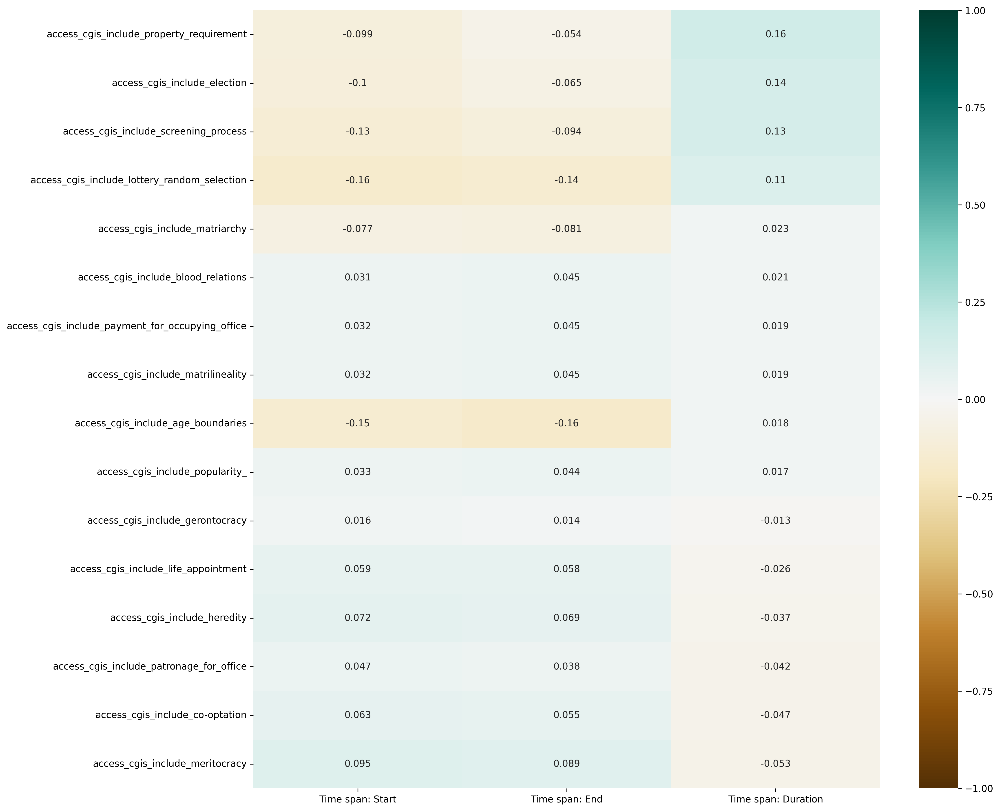

<Figure size 1920x1440 with 0 Axes>

In [66]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_access_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/time_access_cgis.png')

In [67]:
time_decision_making_cgis = time_cgis.loc[decision_making_cgis]

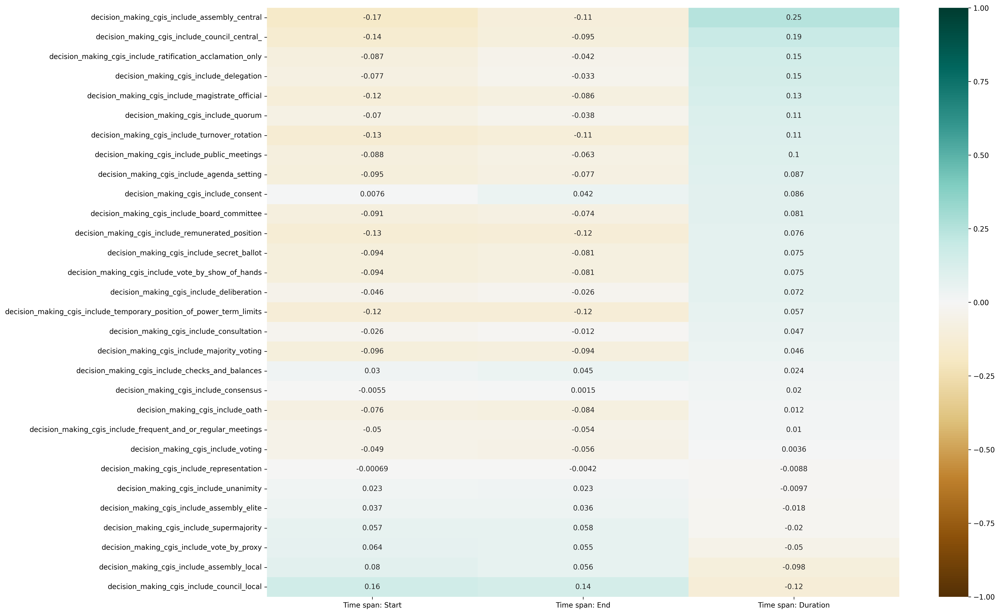

<Figure size 1920x1440 with 0 Axes>

In [68]:
plt.figure(figsize=(20, 15))

sns.heatmap(time_decision_making_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/time_decision_making_cgis.png')

In [69]:
time_enforcement_cgis = time_cgis.loc[enforcement_cgis]

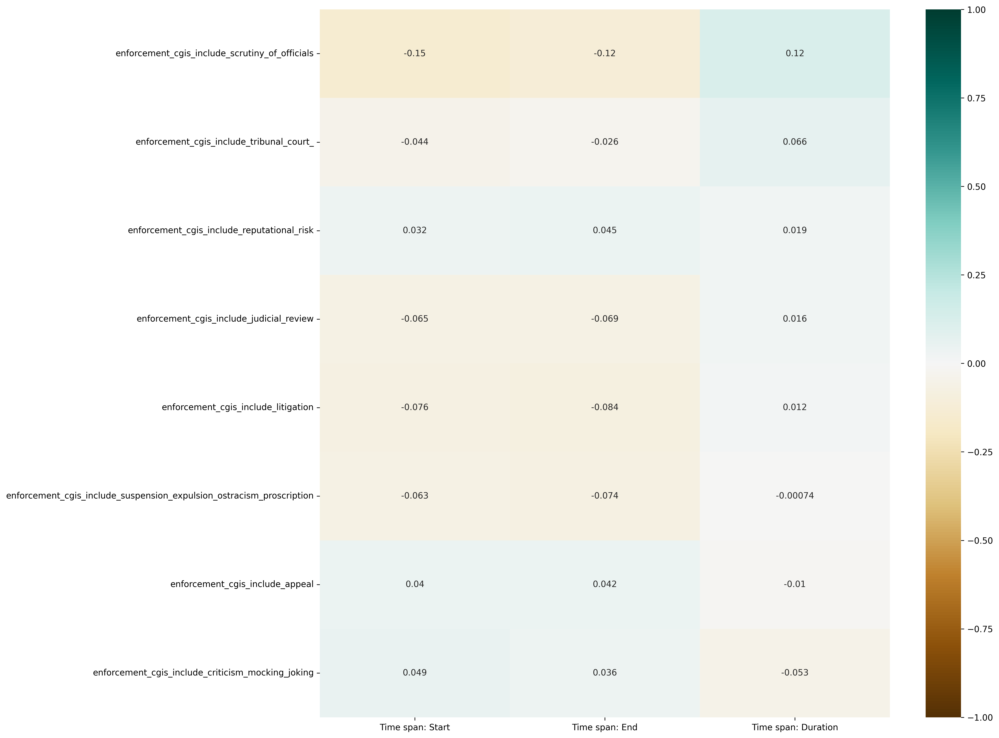

<Figure size 1920x1440 with 0 Axes>

In [70]:
plt.figure(figsize=(15, 15))

sns.heatmap(time_enforcement_cgis.sort_values(by='Time span: Duration', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/time_enforcement_cgis.png')

## Region x CGIs

In [72]:
region_cgis = query_cgis_df[region_cols]
region_cgis

,Region: Africa,Region: Europe,Region: Asia,Region: Middle East,Region: North America,Region: Central America,Region: South America,Region: Oceania
access_cgis_include_matriarchy,-0.017233,0.042061,-0.027572,-0.019068,-0.020783,-0.010588,-0.003049,-0.005297
decision_making_cgis_include_consent,-0.017233,0.039634,-0.027572,-0.019068,-0.020783,-0.010588,-0.003049,-0.005297
decision_making_cgis_include_frequent_and_or_regular_meetings,-0.053283,0.223256,-0.085147,-0.065109,-0.026462,-0.010135,-0.010410,0.050177
enforcement_cgis_include_scrutiny_of_officials,-0.034614,0.265482,-0.055382,-0.038301,-0.041745,-0.021268,-0.006124,-0.010639
decision_making_cgis_include_turnover_rotation,-0.038437,0.260617,-0.061499,-0.042531,-0.046356,0.003359,-0.006800,-0.011814
access_cgis_include_election,-0.045798,0.253956,-0.060490,-0.062379,-0.050572,-0.010638,-0.009974,-0.017328
enforcement_cgis_include_tribunal_court_,-0.039845,0.170520,-0.075097,-0.027591,-0.071104,0.019583,-0.010431,-0.018122
decision_making_cgis_include_ratification_acclamation_only,-0.029232,0.349129,-0.027718,-0.018944,-0.035254,-0.017961,-0.005172,-0.008985
decision_making_cgis_include_agenda_setting,-0.027392,0.177900,-0.043827,-0.030309,0.003309,-0.016831,-0.004846,-0.008419
decision_making_cgis_include_secret_ballot,-0.026904,0.180247,-0.043046,-0.029769,-0.032446,0.021566,-0.004760,-0.008269


In [73]:
# Move Region: Europe to first col 
cols_to_move = ['Region: Europe']
region_cgis = region_cgis[cols_to_move + [col for col in region_cgis.columns if col not in cols_to_move ]]

In [74]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.savefig('../fig/cgis_region.png')

### Region x CGIs: Access, Decision Making, Enforcement

In [75]:
region_access_cgis = region_cgis.loc[access_cgis]

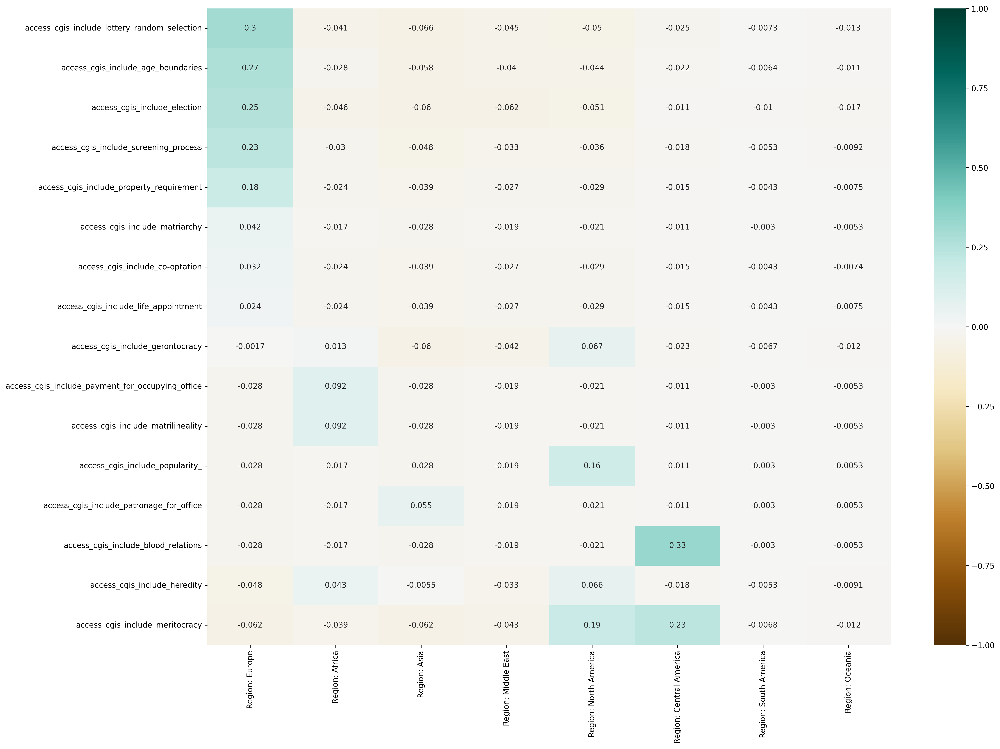

<Figure size 1920x1440 with 0 Axes>

In [76]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_access_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/region_access_cgis.png')

In [77]:
region_decision_making_cgis = region_cgis.loc[decision_making_cgis]

In [78]:
plt.figure(figsize=(40, 30))

sns.heatmap(region_decision_making_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/region_decision_making_cgis.png')

<Figure size 1920x1440 with 0 Axes>

In [79]:
region_enforcement_cgis = region_cgis.loc[enforcement_cgis]

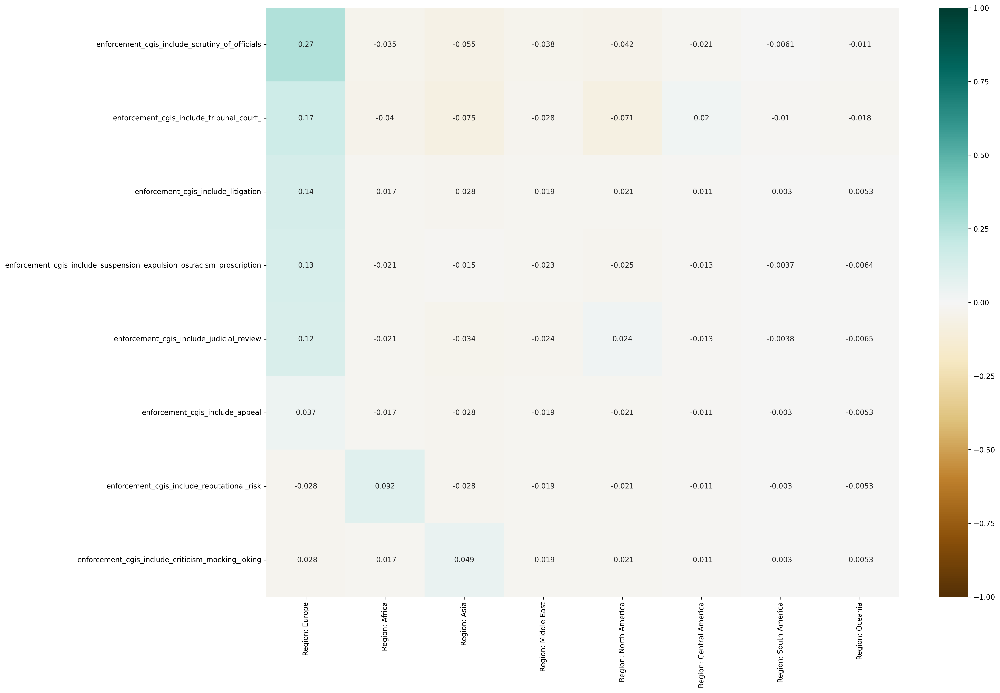

<Figure size 1920x1440 with 0 Axes>

In [80]:
plt.figure(figsize=(20, 15))

sns.heatmap(region_enforcement_cgis.sort_values(by='Region: Europe', ascending=False),
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/region_enforcement_cgis.png')

## Size x CGIs

In [81]:
size_cgis = query_cgis_df[size_cols]

In [83]:
plt.figure(figsize=(40, 30))

sns.heatmap(size_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/cgis_size.png')

<Figure size 1920x1440 with 0 Axes>

### Size x CGIs: Access, Decision Making, Enforcement

In [84]:
size_access_cgis = size_cgis.loc[access_cgis]

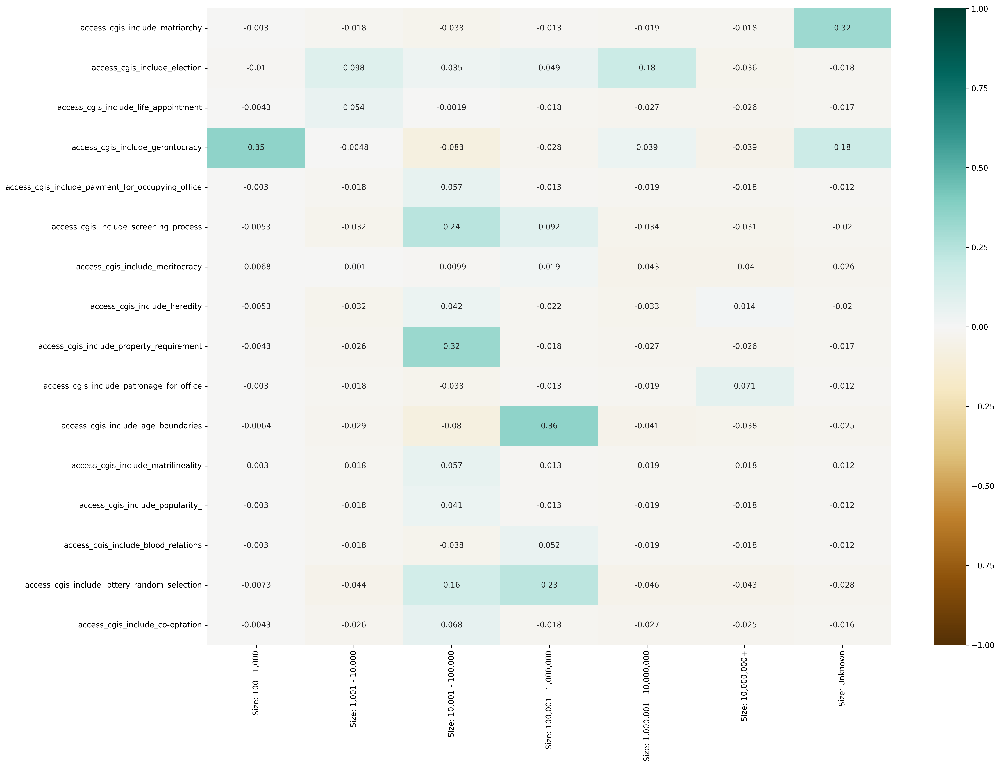

<Figure size 1920x1440 with 0 Axes>

In [85]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_access_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/size_access_cgis.png')

In [86]:
size_decision_making_cgis = size_cgis.loc[decision_making_cgis]

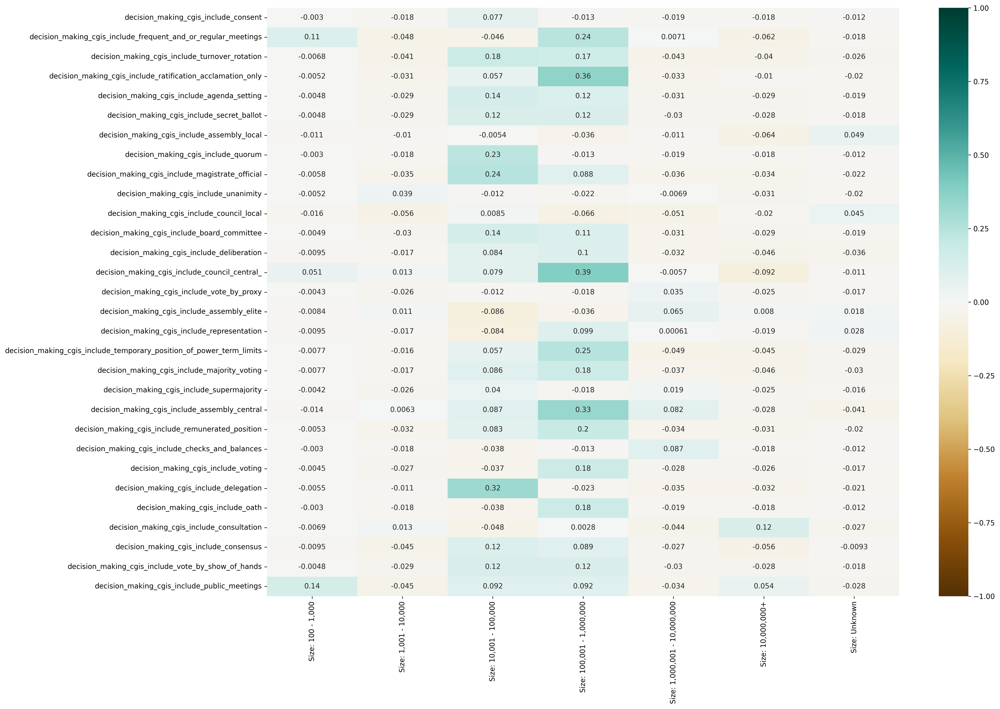

<Figure size 1920x1440 with 0 Axes>

In [87]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_decision_making_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/size_decision_making_cgis.png')

In [88]:
size_enforcement_cgis = size_cgis.loc[enforcement_cgis]

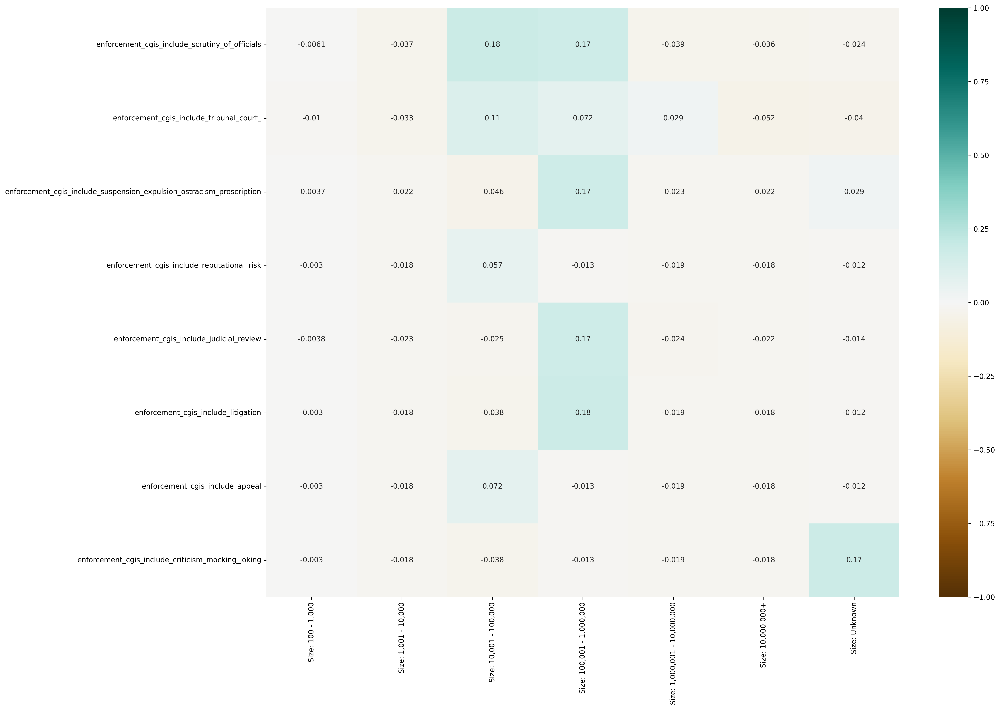

<Figure size 1920x1440 with 0 Axes>

In [89]:
plt.figure(figsize=(20, 15))

sns.heatmap(size_enforcement_cgis,
            vmin=-1, 
            vmax=1, 
            annot=True, 
            cmap='BrBG', 
            xticklabels=1, 
            yticklabels=1
)

plt.show()
plt.savefig('../fig/size_enforcement_cgis.png')

# Sorted positive and negative correlations

In [90]:
def get_redundant_pairs(df):
    '''Get diagonal and lower triangular pairs of correlation matrix'''
    pairs_to_drop = set()
    cols = df.columns
    for i in range(0, df.shape[1]):
        for j in range(0, i+1):
            pairs_to_drop.add((cols[i], cols[j]))
    return pairs_to_drop

In [102]:
def get_sorted_correlations(corr_df, n=100, ascending=False):
    au_corr = corr_df.unstack()
    labels_to_drop = get_redundant_pairs(corr_df)
    au_corr = au_corr.drop(labels=labels_to_drop).sort_values(ascending=ascending)
    return au_corr

In [92]:
# Highest 200 positively correlated variables
print(get_sorted_correlations(norm_corr, n=200, ascending=False))

decision_making_mechanisms_include_lobbying                                      decision_making_mechanisms_include_word_of_mouth                                   1.000000
access_cgis_include_payment_for_occupying_office                                 access_cgis_include_matrilineality                                                 1.000000
enforcement_cgis_include_reputational_risk                                       access_cgis_include_matrilineality                                                 1.000000
enforcement_mechanisms_include_military_force                                    Geography: Asia, China                                                             1.000000
decision_making_mechanisms_include_word_of_mouth                                 Geography: Africa West, Mid-western Nigeria                                        1.000000
decision_making_mechanisms_include_petition                                      Geography: Africa North                               

In [103]:
get_sorted_correlations(norm_corr, n=200, ascending=False).to_csv('../csv/cgis_all_correlations.csv')

In [94]:
# Highest 200 negatively correlated variables 
print(get_sorted_correlations(norm_corr, n=200, ascending=True))

Time span: Start                                                            Time span: Duration                                                               -0.558254
                                                                            decision_making_mechanisms_include_magistrate_official                            -0.555090
                                                                            decision_making_mechanisms_include_assembly_central                               -0.540073
Time span: End                                                              Region: Middle East                                                               -0.498026
                                                                            Geography: Middle East                                                            -0.474795
                                                                            decision_making_mechanisms_include_magistrate_official                            -0

In [95]:
get_sorted_correlations(norm_corr, n=200, ascending=True).to_csv('../csv/cgis_negative_correlations.csv')